# 1. Import required packages

In [1]:
import os

import numpy as np
import pandas as pd
import scanpy as sc
from sklearn.neural_network import MLPClassifier

import matplotlib.pyplot as plt
import seaborn as sns

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

In [2]:
import numpy as np
import pandas as pd
import anndata as ad
from scipy.sparse import csr_matrix
print(ad.__version__)

0.7.8


# 2. Preprocessing

## 2.1 Load AnnData and remove the labeled low quality cells

In [39]:
# load from here for saved raw h5ad
data_path=r'L:\Shiwei\DNA_MERFISH_analysis\SMARTer_nuclei_MOp'
adata = sc.read(os.path.join(data_path,r'MOp_smart_sn_raw.h5ad'))
len(adata)

6278

In [40]:
# remove the labeled 'low-quality cells'
adata = adata[adata.obs['class_label']!='Low Quality']

len(adata)

6171

In [41]:
np.unique(adata.obs['class_label'].tolist())

array(['GABAergic', 'Glutamatergic', 'Non-Neuronal'], dtype='<U13')

In [42]:
np.unique(adata.obs['subclass_label'].tolist())

array(['Astro', 'Endo', 'L2/3 IT', 'L5 ET', 'L5 IT', 'L5/6 NP', 'L6 CT',
       'L6 IT', 'L6b', 'Lamp5', 'Micro', 'OPC', 'Oligo', 'Pvalb', 'Sncg',
       'Sst', 'Vip'], dtype='<U7')

## 2.2 Calculate the QC and inspect the data

In [43]:
# calculate qc metrics using default (for all 'genes')
# inplace set to True to add to adata.var and also adata.obs
# no need to control 'ERCC' or 'mt' since they have been already removed
qc = sc.pp.calculate_qc_metrics(adata,log1p=False,inplace=True) 


Trying to set attribute `.obs` of view, copying.


In [44]:
adata.var

,n_cells,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
0610005C13Rik,89,84,0.462648,0.377249,98.638794,2855.0,7.964851
0610007P14Rik,2702,2681,51.667152,3.953661,56.554853,318838.0,12.679100
0610009B22Rik,1869,1864,32.916058,3.512524,69.794199,203125.0,12.227061
0610009E02Rik,665,659,1.417598,0.883322,89.321018,8748.0,9.094817
0610009L18Rik,372,369,3.398477,1.470714,94.020418,20972.0,9.954514
...,...,...,...,...,...,...,...
Zyx,1586,1568,29.723059,3.414284,74.590828,183421.0,12.125643
Zzef1,2553,2491,32.207260,3.510394,59.633771,198751.0,12.224865
Zzz3,2195,2150,31.876196,3.488652,65.159618,196708.0,12.202446
a,18,18,0.017339,0.016900,99.708313,107.0,4.682131


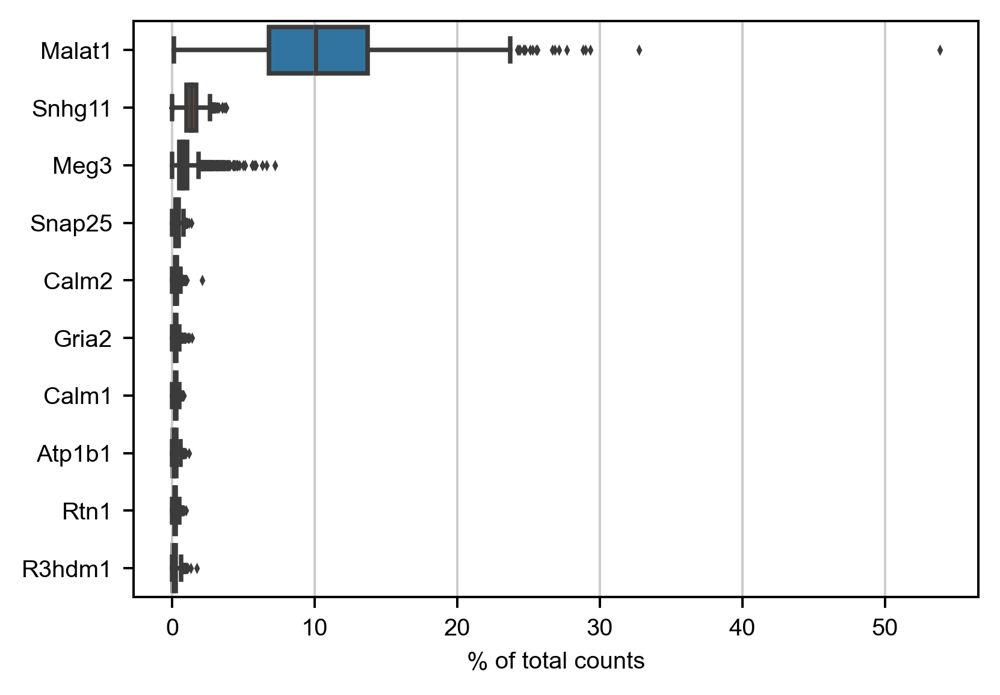

In [45]:
sc.pl.highest_expr_genes(adata, n_top=10, )

## 2.2 Basic filtering to remove genes and cells with low information

In [46]:
# remove cells with small number of genes detected
sc.pp.filter_cells(adata, min_genes=200)
# remove genes that are not frequently detected in cells
sc.pp.filter_genes(adata, min_cells=3)

In [47]:
len(adata)

6171

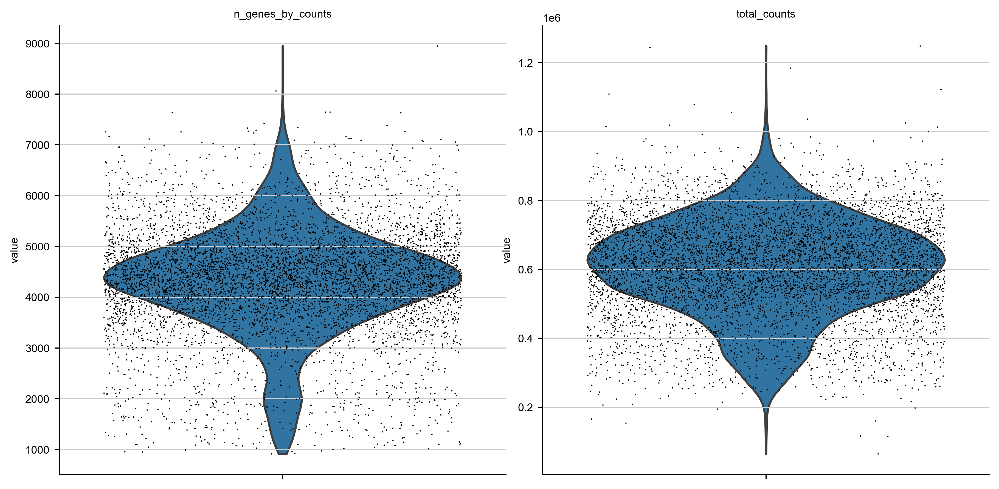

In [48]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

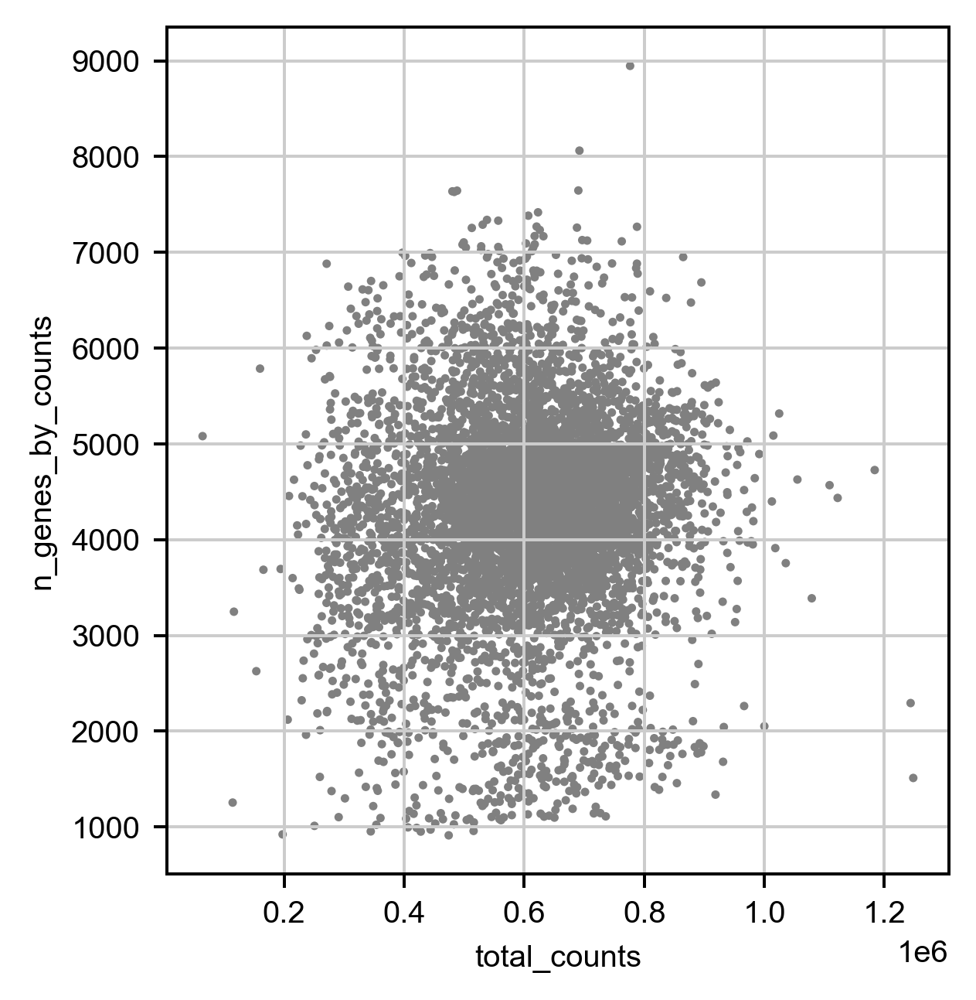

In [49]:
#sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
# There is not much correlation between total counts and genes_by_counts for the SMART-seq which has high depth for reads
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [50]:
# filter out some outiliers based on the total counts and n_gene_by_counts

adata = adata[adata.obs['total_counts'] > 100]
adata = adata[adata.obs['n_genes_by_counts'] > 100]
len(adata)

6171

## 2.3 Normalization and scaling

In [51]:
# library size control; normalize to the median

sc.pp.normalize_total(adata, target_sum=0.6*1e6 )

C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


## 2.4 Save adata raw for retrieving info during subsequent analyese

In [52]:
# save raw adata before log1p (and filtering out the non-variable gene in below steps)
# so we can use them for marker gene analysis later (especially for log2foldchanges as division by 0 return nan/inf)

adata.raw = adata

# proceed with the log1p transformed data for clustering visualization 

## 2.5 Show expression as log1p format

In [ ]:
# consider use this also for adata raw for correlation if necessary

In [53]:
# log1p to scale the counts to center around 0
# log(1+x) 
#  The +1 makes sure that 0 values in the original data still map to 0 in log space (and prevents us from trying to take the log of 0). This makes the expression values more closely approximate a Gaussian distribution, 
#which is an assumption inherent to many downstream analysis methods
sc.pp.log1p(adata)

## 2.6 Only use highly variable genes for culstering 

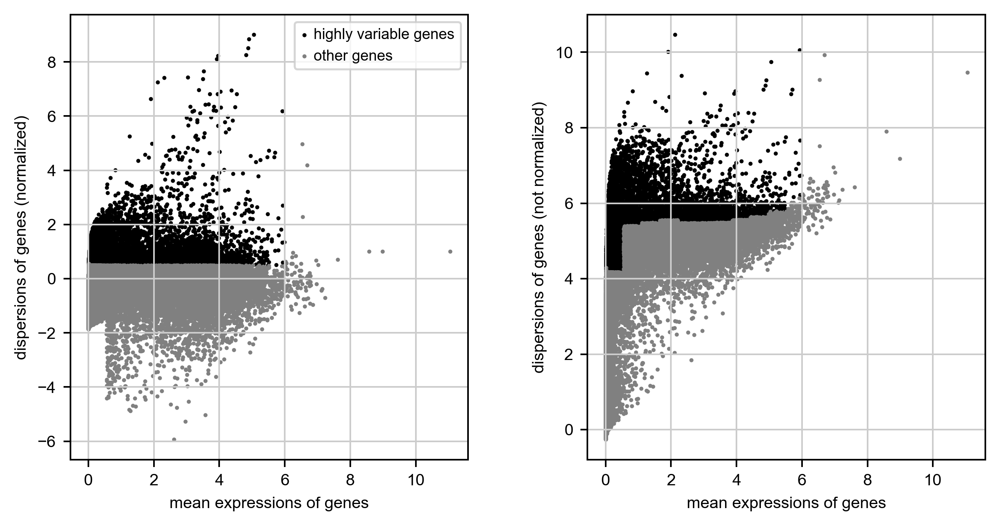

In [54]:
# check higly varibale genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=6, min_disp=0.5)

sc.pl.highly_variable_genes(adata)

In [55]:
#Keep only the variable genes and regress by total count


adata = adata[:, adata.var.highly_variable]

# Regress out total counts
sc.pp.regress_out(adata, 'total_counts')  # because it appears the detection efficiency is also determing the numbber


In [56]:
# Clip values exceeding standard deviation 10.

# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

# 3. PCA analysis

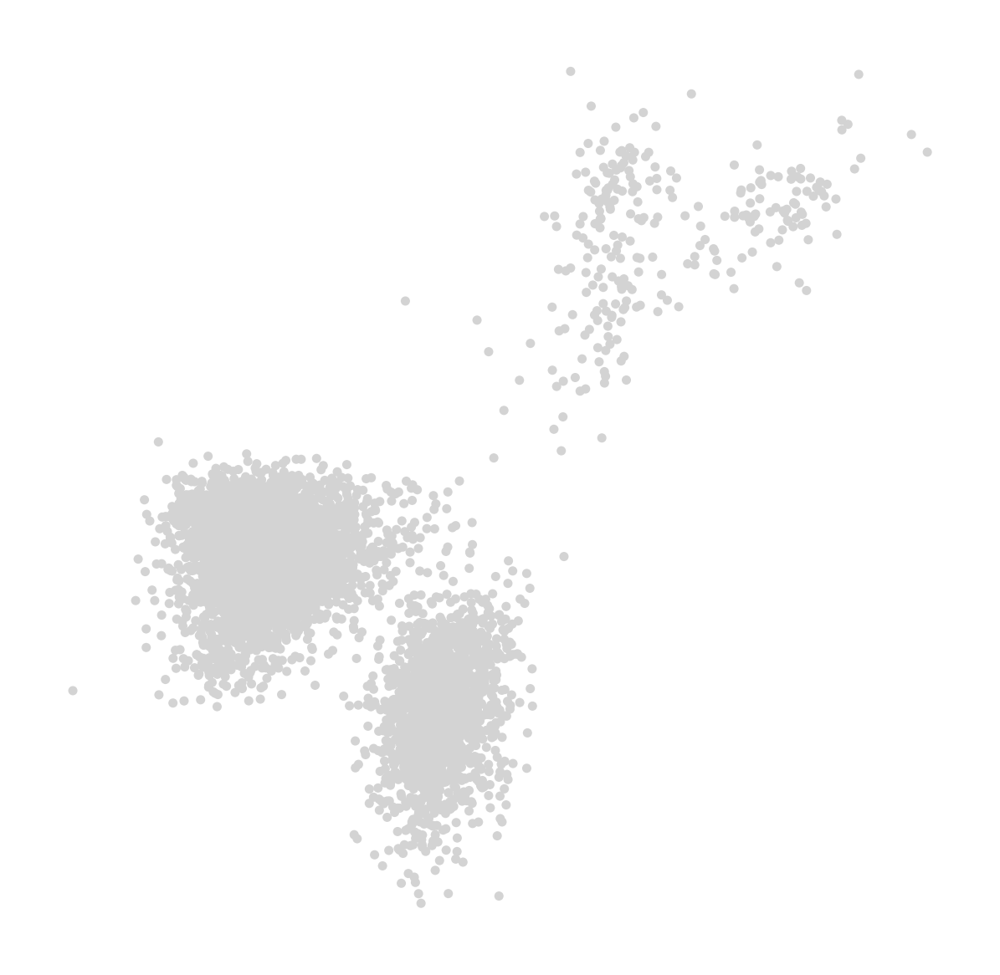

C:\Users\shiwei\Anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:238: RuntimeWarning: Glyph 8942 missing from current font.
  font.set_text(s, 0.0, flags=flags)
C:\Users\shiwei\Anaconda3\lib\site-packages\matplotlib\backends\backend_agg.py:201: RuntimeWarning: Glyph 8942 missing from current font.
  font.set_text(s, 0, flags=flags)


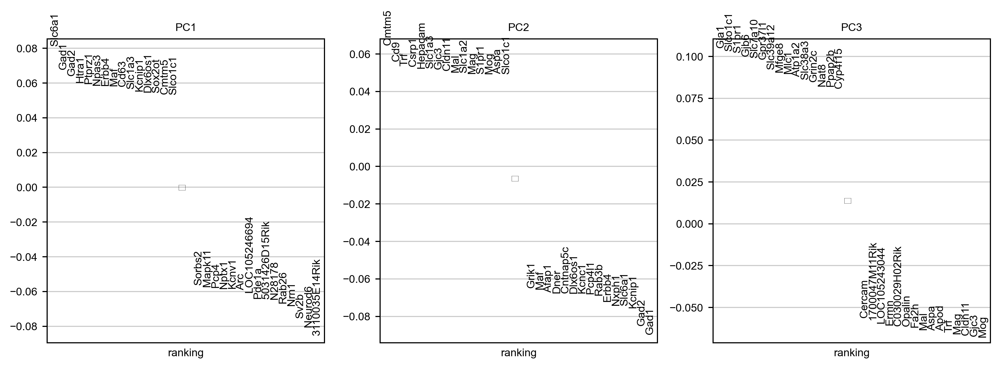

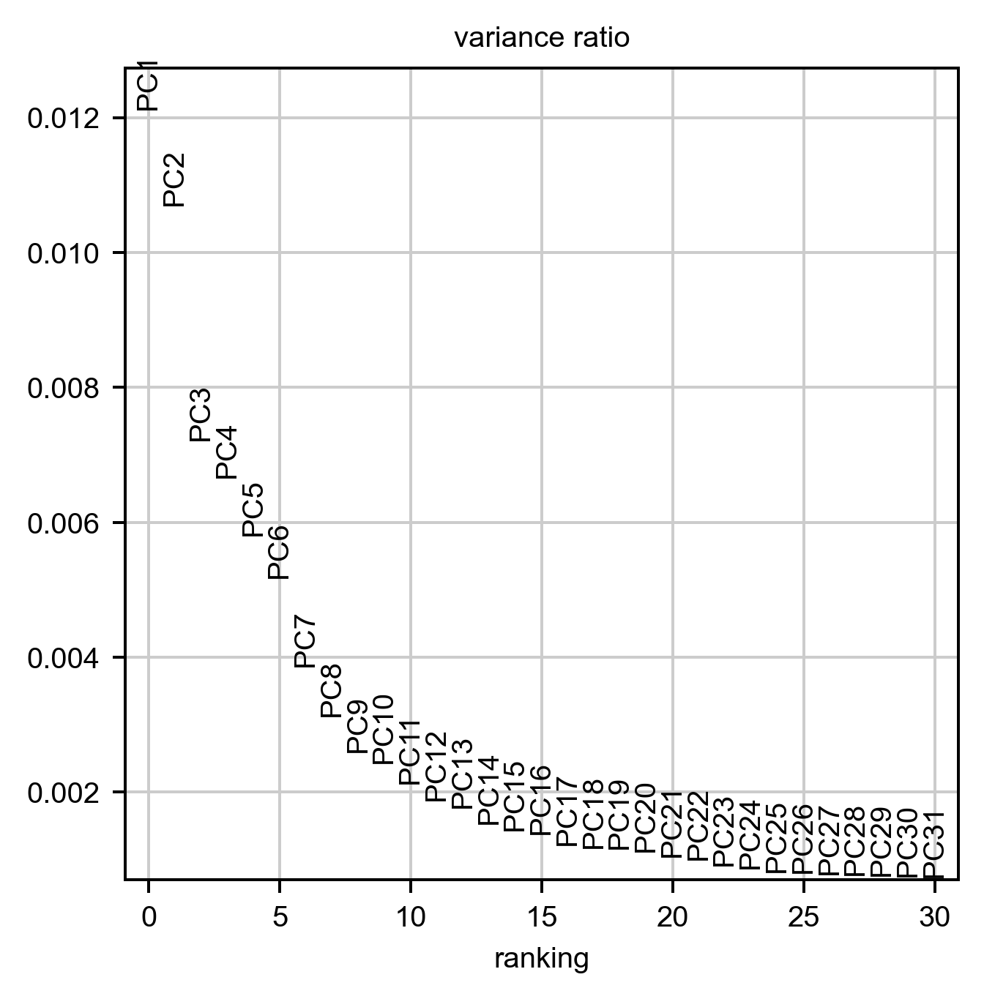

In [57]:
sc.pp.pca(adata)

sc.pl.pca_overview(adata)

In [58]:
np.unique(adata.obs['class_label'])

array(['GABAergic', 'Glutamatergic', 'Non-Neuronal'], dtype=object)

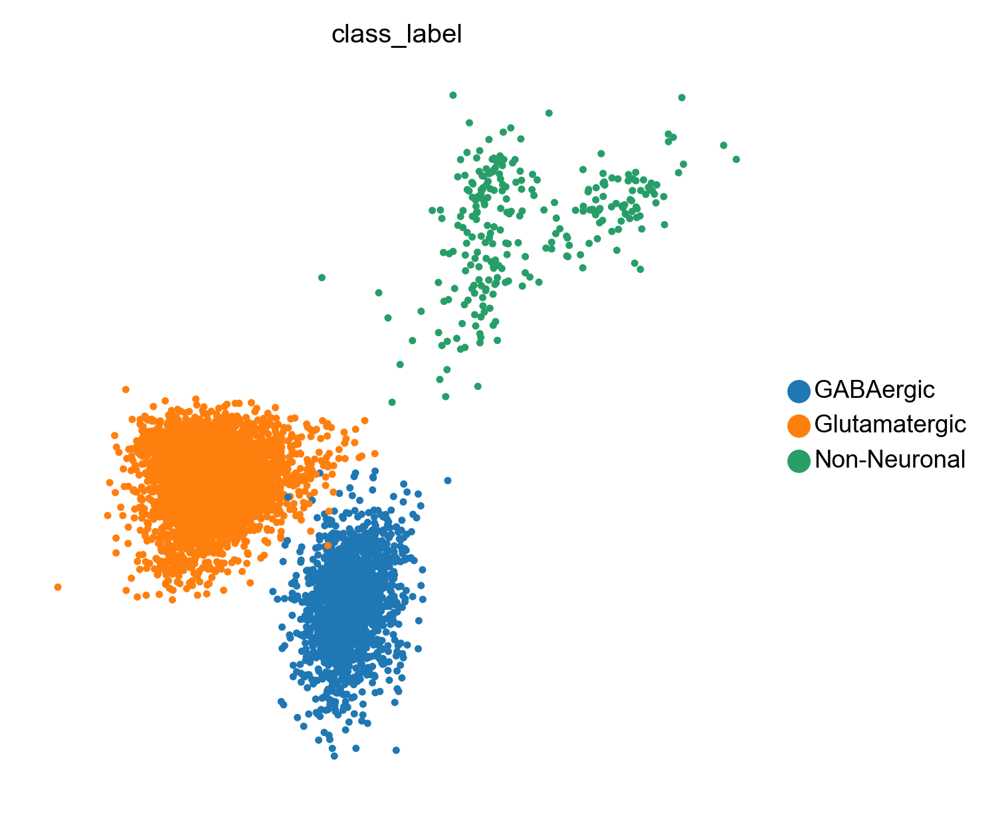

In [59]:
# check if PCA makes sense by plotting agianst the pre-labeled class

sc.pl.pca(adata, color='class_label')

# 4. Neighborhood and clustering

In [60]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=30)

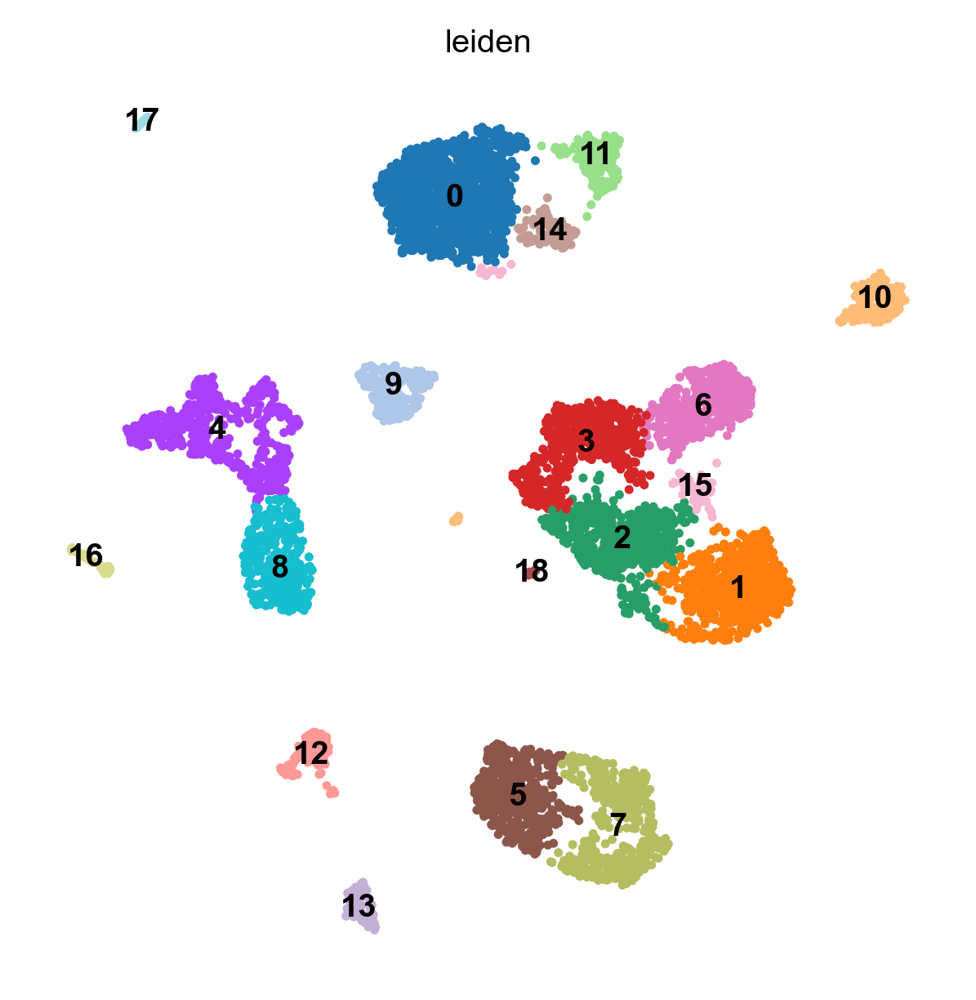

Wall time: 14.1 s


In [61]:
%%time
# Clustering
sc.tl.leiden(adata, resolution=0.5)

# Embed with UMAP
sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='leiden', legend_loc='on data')

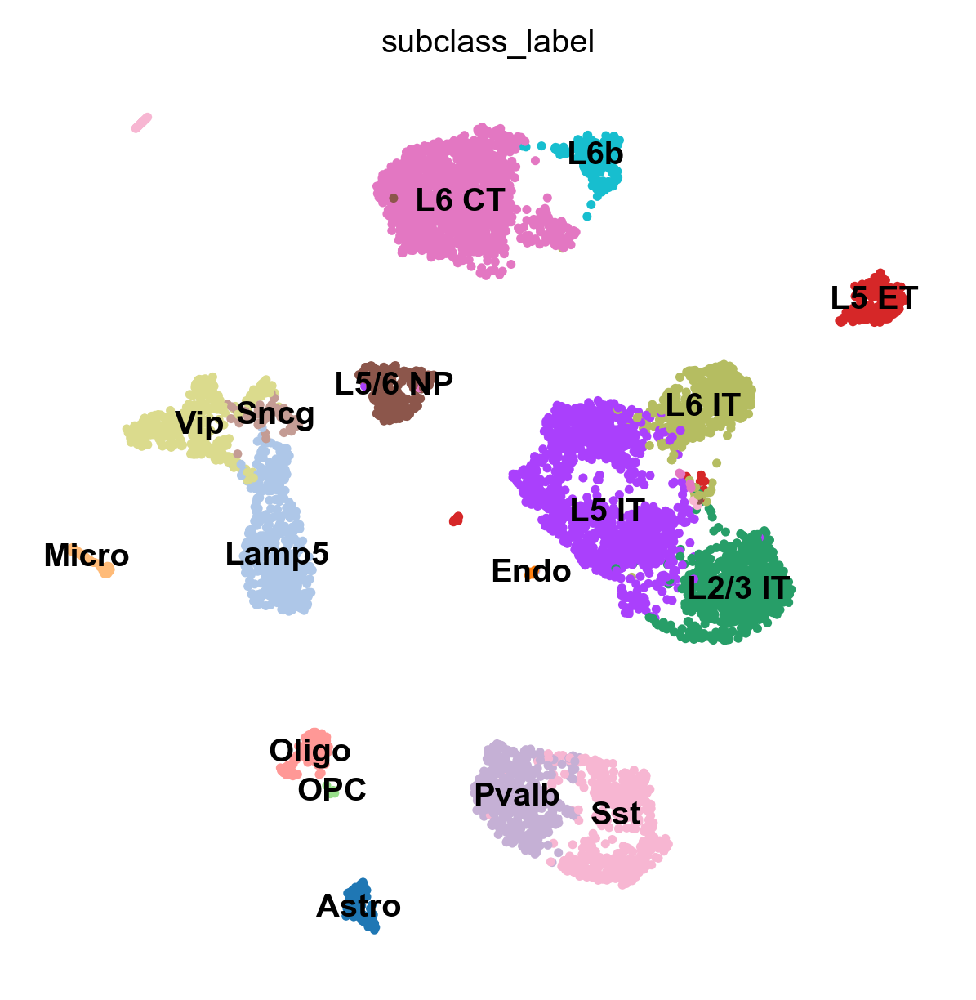

In [62]:
# Plot the UMAP
sc.pl.umap(adata, color='subclass_label', legend_loc='on data')

# 5. Re-label subclass to match MERFISH result

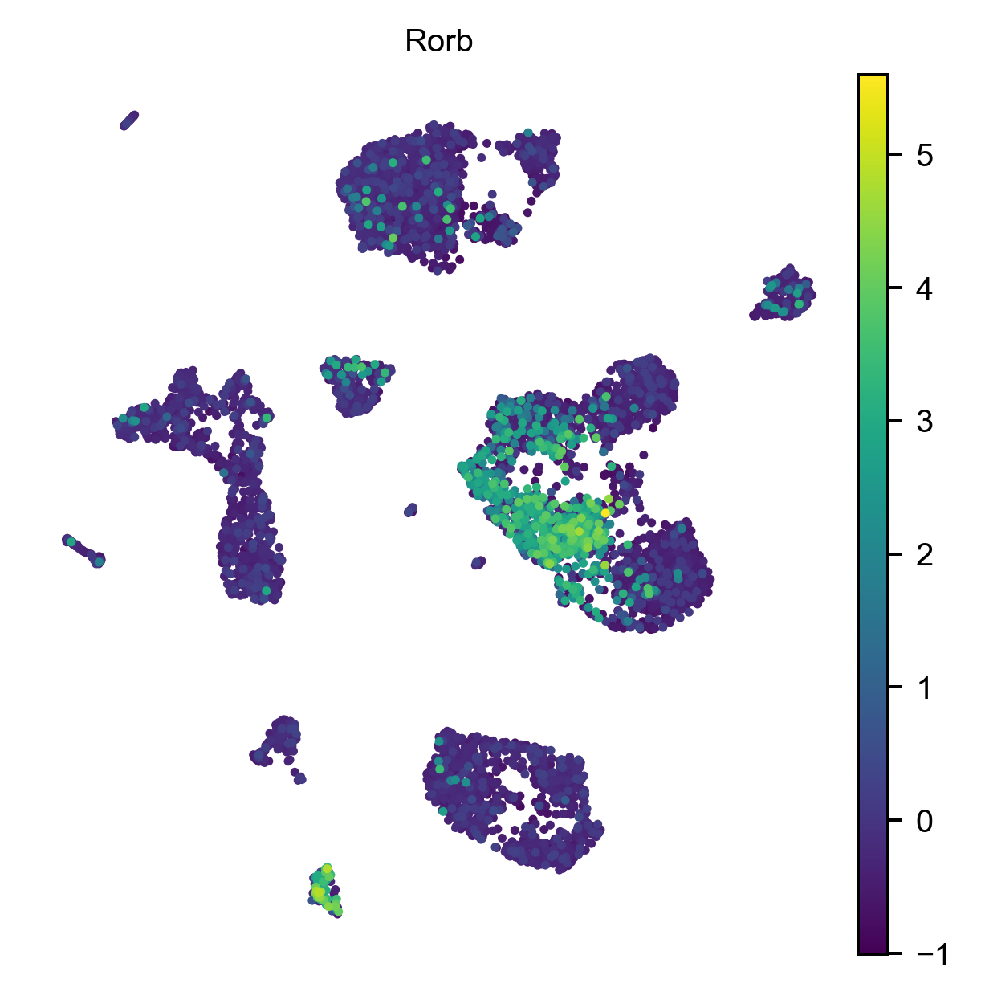

In [67]:
# try distingish L4/5 IT and L5 IT (leiden 2, 16, 3) by gene expression

#adata_ori = adata.raw.to_adata()

marker_genes =  ['Slc30a3','Cux2', 'Rorb']
marker_genes = [g for g in marker_genes if (g in adata.var.index)]

sc.pl.umap(adata, color=marker_genes, use_raw=False)

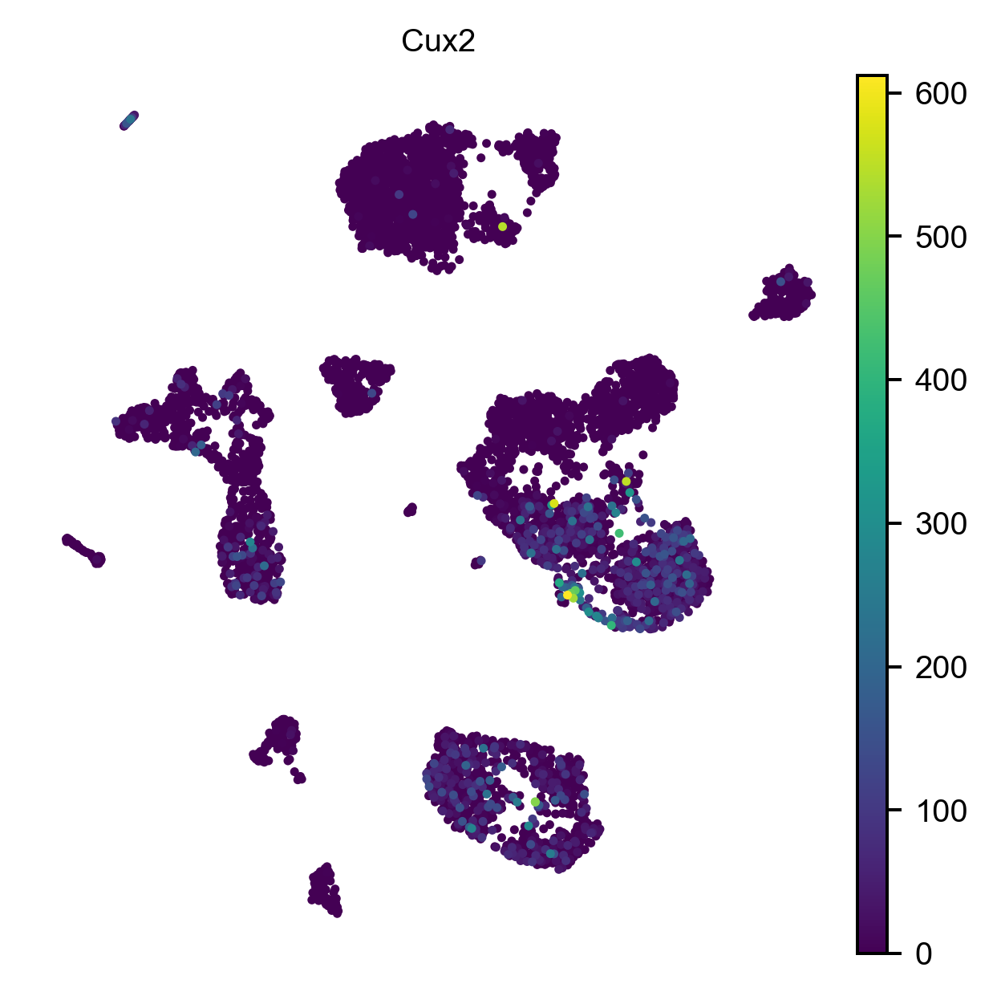

In [77]:
# check CUX2 from the original genes 

adata_ori = adata.raw.to_adata()
sc.pl.umap(adata_ori, color=['Cux2'], use_raw=False)

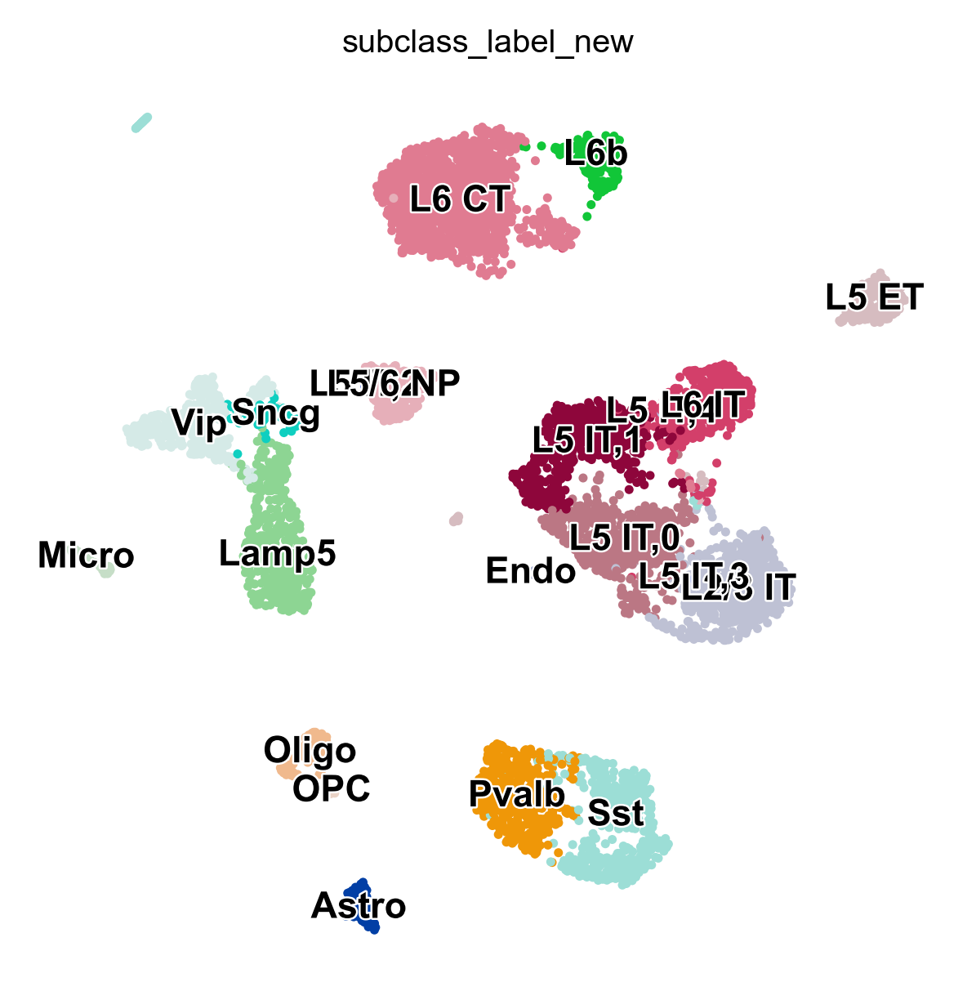

Wall time: 13.7 s


In [81]:
%%time
# sub-split the L5 IT  to obtain  L4/5 IT and L5 IT and compare the above marker gene map
# adjust resolution to test
sc.tl.leiden(adata, resolution=0.05,restrict_to=('subclass_label',['L5 IT']),
           key_added='subclass_label_new')


sc.tl.umap(adata)
# Plot the UMAP
sc.pl.umap(adata, color='subclass_label_new', 
           legend_loc='on data',legend_fontsize=9,legend_fontoutline=1)

In [82]:
np.unique(adata.obs['subclass_label_new'].tolist())

array(['Astro', 'Endo', 'L2/3 IT', 'L5 ET', 'L5 IT,0', 'L5 IT,1',
       'L5 IT,2', 'L5 IT,3', 'L5 IT,4', 'L5/6 NP', 'L6 CT', 'L6 IT',
       'L6b', 'Lamp5', 'Micro', 'OPC', 'Oligo', 'Pvalb', 'Sncg', 'Sst',
       'Vip'], dtype='<U7')

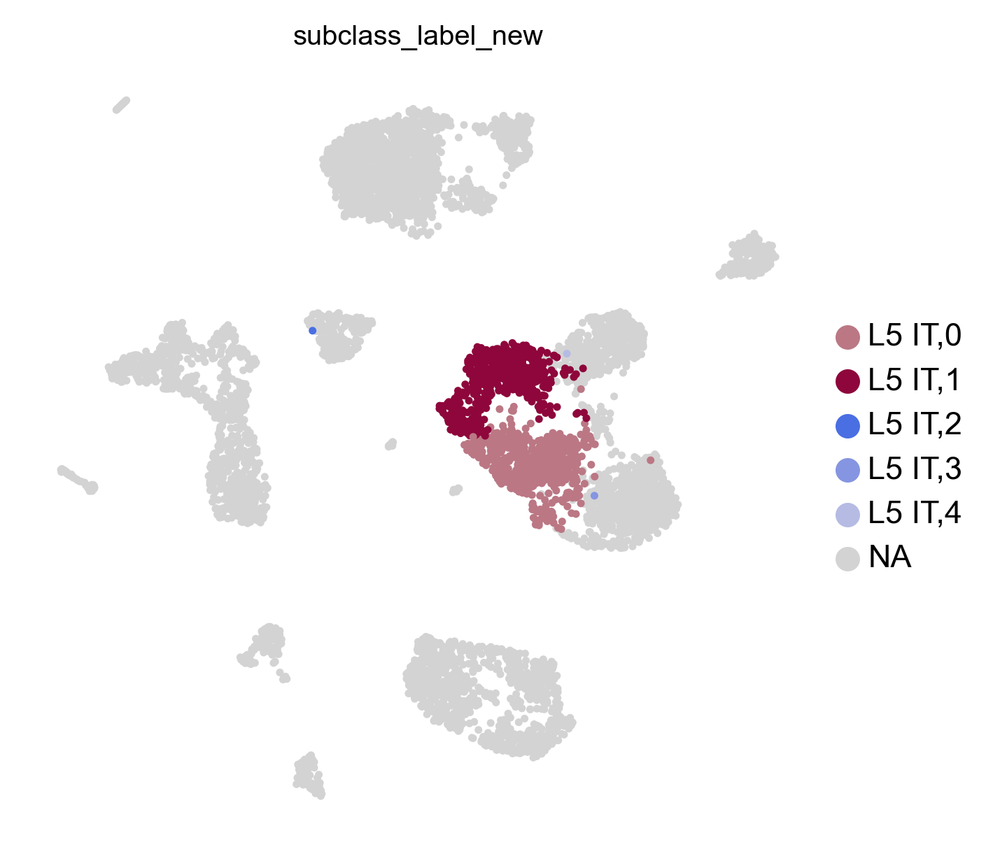

In [84]:
sc.pl.umap(adata, color='subclass_label_new', groups=['L5 IT,0','L5 IT,1','L5 IT,2','L5 IT,3','L5 IT,4'],
           legend_fontsize=9,legend_fontoutline=1)

In [85]:
# re-label subclass based on Cux2 and Rorb expression level
adata.obs = adata.obs.replace({'subclass_label_new':{'L5 IT,1':'L5 IT','L5 IT,4':'L5 IT'}})

adata.obs = adata.obs.replace({'subclass_label_new':{'L5 IT,0':'L4/5 IT','L5 IT,3':'L4/5 IT'}})

adata.obs = adata.obs.replace({'subclass_label_new':{'L5 IT,2':'L5/6 NP'}})



In [86]:
np.unique(adata.obs['subclass_label_new'])

array(['Astro', 'Endo', 'L2/3 IT', 'L4/5 IT', 'L5 ET', 'L5 IT', 'L5/6 NP',
       'L6 CT', 'L6 IT', 'L6b', 'Lamp5', 'Micro', 'OPC', 'Oligo', 'Pvalb',
       'Sncg', 'Sst', 'Vip'], dtype=object)

... storing 'subclass_label_new' as categorical


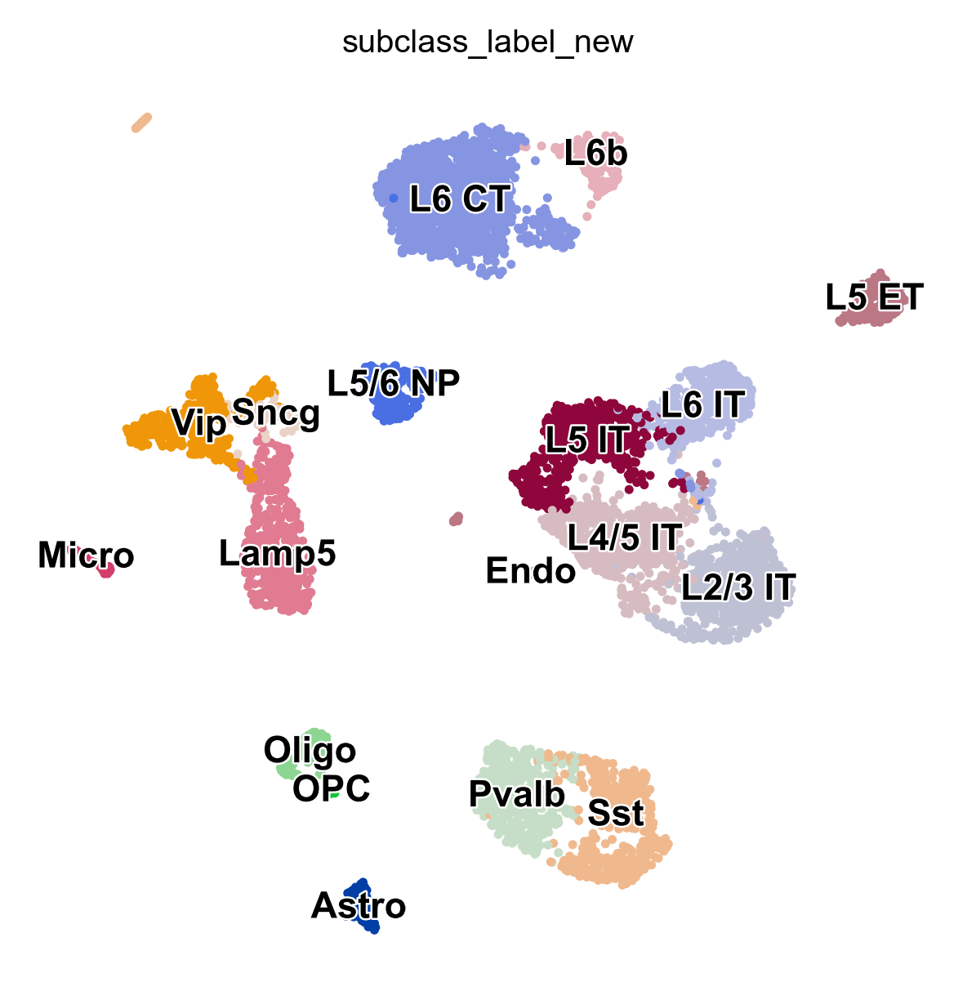

In [87]:
sc.pl.umap(adata, color='subclass_label_new', 
           legend_loc='on data',legend_fontsize=9,legend_fontoutline=1)

# 6. Add new class annotation

## 6.1 Major 'classes'

In [89]:
# duplicate the column for manual labeling of the final classes
adata.obs['class_label_new'] = adata.obs['subclass_label_new'] 

In [90]:
new_class_dict = {}

for _class in ['L2/3 IT', 'L4/5 IT', 'L5 ET', 'L5 IT', 'L5/6 NP','L6 CT', 'L6 IT', 'L6b']:
    new_class_dict[_class]='Gluta'
    
for _class in ['Lamp5','Pvalb', 'Sncg', 'Sst', 'Vip']:
    new_class_dict[_class]='GABA'
    
for _class in ['OPC','Oligo']:
    new_class_dict[_class]='Oligo'
    
for _class in ['Astro']:
    new_class_dict[_class]='Astro'
    
for _class in ['Micro']:
    new_class_dict[_class]='Micro'
    
for _class in ['Endo']:
    new_class_dict[_class]='Endo'

new_class_dict   

{'L2/3 IT': 'Gluta',
 'L4/5 IT': 'Gluta',
 'L5 ET': 'Gluta',
 'L5 IT': 'Gluta',
 'L5/6 NP': 'Gluta',
 'L6 CT': 'Gluta',
 'L6 IT': 'Gluta',
 'L6b': 'Gluta',
 'Lamp5': 'GABA',
 'Pvalb': 'GABA',
 'Sncg': 'GABA',
 'Sst': 'GABA',
 'Vip': 'GABA',
 'OPC': 'Oligo',
 'Oligo': 'Oligo',
 'Astro': 'Astro',
 'Micro': 'Micro',
 'Endo': 'Endo'}

In [91]:
# re-label subclass based on Cux2 and Rorb expression level

new_class_label_dict ={'class_label_new':new_class_dict}

adata.obs = adata.obs.replace(new_class_label_dict)


In [134]:
np.unique(adata.obs['class_label_new'] )

array(['Astro', 'Endo', 'GABA', 'Gluta', 'Micro', 'Oligo'], dtype=object)

## 6.2 Neuron vs non-Neuron

In [92]:
# duplicate the column for manual labeling of the final classes
adata.obs['neuron_identity'] = adata.obs['class_label'] 

In [93]:
# re-label subclass based on Cux2 and Rorb expression level

new_class_dict = {}

new_class_dict['Glutamatergic']='Neuronal'
new_class_dict['GABAergic']='Neuronal'
new_class_dict['Non-Neuronal']='Non-Neuronal'

new_class_label_dict ={'neuron_identity':new_class_dict}

adata.obs = adata.obs.replace(new_class_label_dict)

np.unique(adata.obs['neuron_identity'] )

array(['Neuronal', 'Non-Neuronal'], dtype=object)

# 7. Save the labeled annData

In [94]:
adata.write(os.path.join(data_path,r'MOp_smart_sn_labeled_20220707.h5ad'))

... storing 'class_label_new' as categorical
... storing 'neuron_identity' as categorical


# 8. Find marker genes between subclasses

## 8.1 Find markers using raw adata

In [124]:
# Perform marker gene analysis (using the class label direclty, independent of the UMAP visualization)

class_list = ['Gluta','GABA']
groupby_type='class_label_new'



#class_list = ['Neuronal','Non-Neuronal']
#groupby_type='neuron_identity'


both_way=True
add_control=False
test_method='wilcoxon'
#test_method='t-test'
#test_method='logreg'

sel_gene_list_dict={}
use_raw=True
n_genes=100

class1=class_list[0]
class2=class_list[1]
sc.tl.rank_genes_groups(adata,groupby=groupby_type, groups=[class1],method=test_method,
                        reference=class2,  # or 'rest' as default
                        use_raw=use_raw,
                         pts=True)

all_compared_gene_list=[]
all_compared_score_list=[]
for _gene, _score in zip(adata.uns['rank_genes_groups']['names'],adata.uns['rank_genes_groups']['scores']):
    all_compared_gene_list.append(_gene[0])
    all_compared_score_list.append(_score[0])
    
if both_way:
    # get the first 100 up-regulated genes
    sel_gene_list_dict['upregulated'] =all_compared_gene_list[:n_genes]
    #sel_gene_list_dict['upregulated'] =np.intersect1d(sel_gene_list_dict['upregulated'], linc_genes)
    # get the last 100 for down-regulated genes and sort them reversely
    down_gene_list = all_compared_gene_list[-n_genes:]
    down_gene_list.reverse()
    sel_gene_list_dict['downregulated'] =down_gene_list
    #sel_gene_list_dict['downregulated'] =np.intersect1d(sel_gene_list_dict['downregulated'], linc_genes)
        
if add_control:
    for _gene, _score in zip(all_compared_gene_list,all_compared_score_list):
        if abs(_score)==0:
            control_gene_list.append(_gene)
    control_size = np.min((300, len(control_gene_list)))
    print (f'{len(control_gene_list)} Control genes with z-score close to 0 added.')
    # pick 150 from above randomly
    print (f'Pick {control_size} control genes randomly from all candidates.')
    sel_gene_list_dict['control']= np.random.choice(control_gene_list,control_size)
    


_final_class_list = class_list
%store _final_class_list
%store sel_gene_list_dict


Stored '_final_class_list' (list)
Stored 'sel_gene_list_dict' (dict)


C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\tools\_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\tools\_rank_genes_groups.py:418: RuntimeWarning: overflow encountered in expm1
  self.expm1_func(mean_rest) + 1e-9
C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\tools\_rank_genes_groups.py:417: RuntimeWarning: invalid value encountered in true_divide
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: divide by zero encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


In [125]:
# from use raw
adata.uns['rank_genes_groups']['pts']

,Gluta,GABA
0610005C13Rik,0.011279,0.016055
0610007P14Rik,0.453084,0.423739
0610009B22Rik,0.300936,0.331995
0610009E02Rik,0.123350,0.081995
0610009L18Rik,0.050156,0.088303
...,...,...
Zyx,0.261339,0.264335
Zzef1,0.422126,0.397936
Zzz3,0.392369,0.278096
a,0.002880,0.003440


In [126]:
# from use raw
adata.uns['rank_genes_groups']['logfoldchanges']

rec.array([( 576.0089 ,), ( 318.01633,), (       inf,), ...,
           (-744.94183,), (      -inf,), (-639.3628 ,)],
          dtype=[('Gluta', '<f4')])

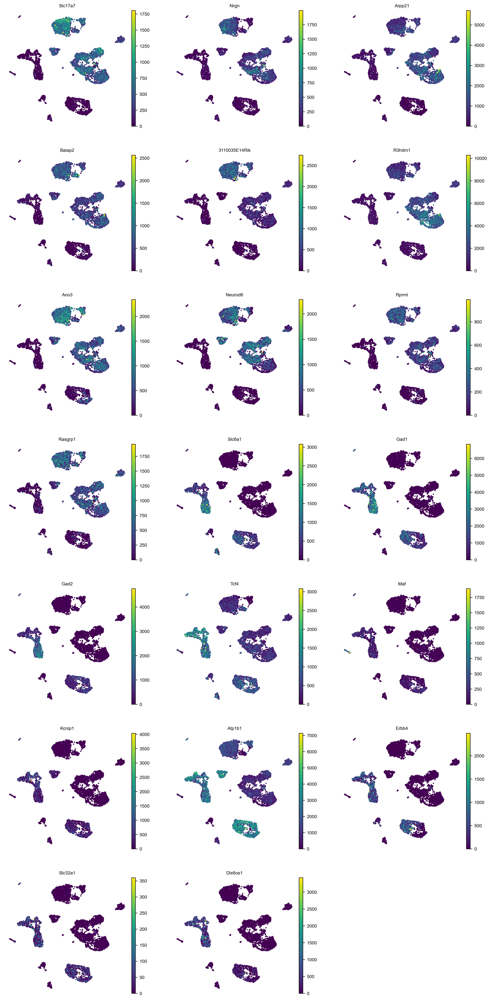

In [127]:
# if quick checking the marker gene expression distribution ( 3 each gene for both up and down regulated and control)
_check_markers=True
if _check_markers:
    sel_gene_list_plot=[]
    for _gene in sel_gene_list_dict['upregulated'][:10]:
        sel_gene_list_plot.append(_gene)
    for _gene in sel_gene_list_dict['downregulated'][:10]:
        sel_gene_list_plot.append(_gene)
    if add_control:
        for _gene in sel_gene_list_dict['control'][-3:]:
            sel_gene_list_plot.append(_gene)    
        
    #_filtered_gene_list = [_g for _g in sel_gene_list_plot if _g in adata.var.index]
    sc.pl.umap(adata, color=sel_gene_list_plot,ncols=3,legend_loc='on data')

## 8.2 Find markers using transformed data

In [115]:
# Perform marker gene analysis (using the class label direclty, independent of the UMAP visualization)

class_list = ['Gluta','GABA']
groupby_type='class_label_new'



#class_list = ['Neuronal','Non-Neuronal']
#groupby_type='neuron_identity'


both_way=True
add_control=False
test_method='wilcoxon'
#test_method='t-test'
#test_method='logreg'

sel_gene_list_dict={}
use_raw=False
n_genes=100

class1=class_list[0]
class2=class_list[1]
sc.tl.rank_genes_groups(adata,groupby=groupby_type, groups=[class1],method=test_method,
                        reference=class2,  # or 'rest' as default
                        use_raw=use_raw,
                         pts=True)

all_compared_gene_list=[]
all_compared_score_list=[]
for _gene, _score in zip(adata.uns['rank_genes_groups']['names'],adata.uns['rank_genes_groups']['scores']):
    all_compared_gene_list.append(_gene[0])
    all_compared_score_list.append(_score[0])
    
if both_way:
    # get the first 100 up-regulated genes
    sel_gene_list_dict['upregulated'] =all_compared_gene_list[:n_genes]
    #sel_gene_list_dict['upregulated'] =np.intersect1d(sel_gene_list_dict['upregulated'], linc_genes)
    # get the last 100 for down-regulated genes and sort them reversely
    down_gene_list = all_compared_gene_list[-n_genes:]
    down_gene_list.reverse()
    sel_gene_list_dict['downregulated'] =down_gene_list
    #sel_gene_list_dict['downregulated'] =np.intersect1d(sel_gene_list_dict['downregulated'], linc_genes)
        
if add_control:
    for _gene, _score in zip(all_compared_gene_list,all_compared_score_list):
        if abs(_score)==0:
            control_gene_list.append(_gene)
    control_size = np.min((300, len(control_gene_list)))
    print (f'{len(control_gene_list)} Control genes with z-score close to 0 added.')
    # pick 150 from above randomly
    print (f'Pick {control_size} control genes randomly from all candidates.')
    sel_gene_list_dict['control']= np.random.choice(control_gene_list,control_size)
    


_final_class_list = class_list
%store _final_class_list
%store sel_gene_list_dict


Stored '_final_class_list' (list)
Stored 'sel_gene_list_dict' (dict)


C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


In [116]:
# from transformed
adata.uns['rank_genes_groups']['pts']


,Gluta,GABA
0610005C13Rik,1.0,1.0
0610039H22Rik,1.0,1.0
0610040J01Rik,1.0,1.0
1110020A21Rik,1.0,1.0
1110028F11Rik,1.0,1.0
...,...,...
Zswim1,1.0,1.0
Zswim2,1.0,1.0
Zswim3,1.0,1.0
Zxdc,1.0,1.0


In [117]:
# from transformed

adata.uns['rank_genes_groups']['logfoldchanges']

rec.array([(nan,), (nan,), (nan,), ..., (nan,), (nan,), (nan,)],
          dtype=[('Gluta', '<f4')])

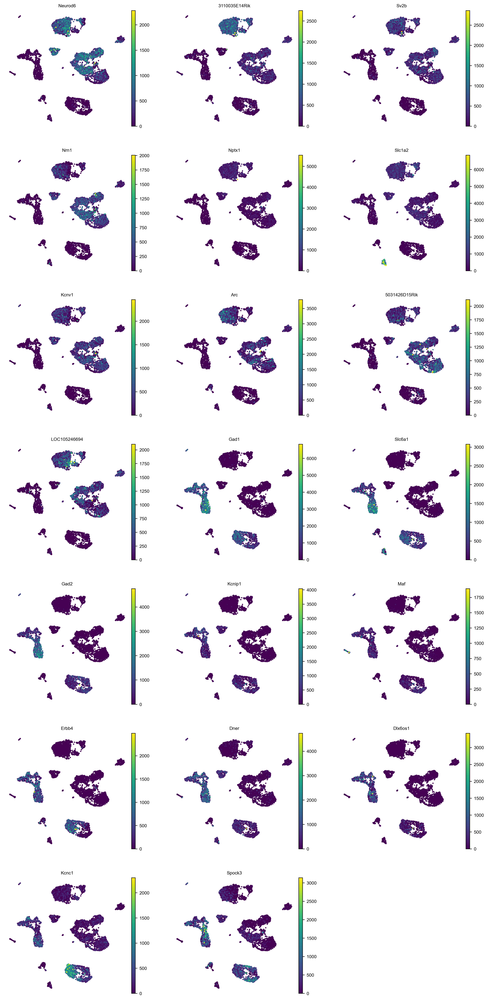

In [119]:
# if quick checking the marker gene expression distribution ( 3 each gene for both up and down regulated and control)
_check_markers=True
if _check_markers:
    sel_gene_list_plot=[]
    for _gene in sel_gene_list_dict['upregulated'][:10]:
        sel_gene_list_plot.append(_gene)
    for _gene in sel_gene_list_dict['downregulated'][:10]:
        sel_gene_list_plot.append(_gene)
    if add_control:
        for _gene in sel_gene_list_dict['control'][-3:]:
            sel_gene_list_plot.append(_gene)    
        
    #_filtered_gene_list = [_g for _g in sel_gene_list_plot if _g in adata.var.index]
    sc.pl.umap(adata, color=sel_gene_list_plot,ncols=3,legend_loc='on data')

In [123]:
print('Slc17a7' in adata.var.index)

print('Slc17a7' in adata_ori.var.index)

False
True


## 8.3 Find markers using rank-sum 'final' example

In [128]:
# Perform marker gene analysis (using the class label direclty, independent of the UMAP visualization)

class_list = ['Gluta','Astro']
groupby_type='class_label_new'



#class_list = ['Neuronal','Non-Neuronal']
#groupby_type='neuron_identity'


both_way=True
add_control=False
test_method='wilcoxon'
#test_method='t-test'
#test_method='logreg'

sel_gene_list_dict={}
use_raw=True
n_genes=100

class1=class_list[0]
class2=class_list[1]
sc.tl.rank_genes_groups(adata,groupby=groupby_type, groups=[class1],method=test_method,
                        reference=class2,  # or 'rest' as default
                        use_raw=use_raw,
                         pts=True)

all_compared_gene_list=[]
all_compared_score_list=[]
for _gene, _score in zip(adata.uns['rank_genes_groups']['names'],adata.uns['rank_genes_groups']['scores']):
    all_compared_gene_list.append(_gene[0])
    all_compared_score_list.append(_score[0])
    
if both_way:
    # get the first 100 up-regulated genes
    sel_gene_list_dict['upregulated'] =all_compared_gene_list[:n_genes]
    #sel_gene_list_dict['upregulated'] =np.intersect1d(sel_gene_list_dict['upregulated'], linc_genes)
    # get the last 100 for down-regulated genes and sort them reversely
    down_gene_list = all_compared_gene_list[-n_genes:]
    down_gene_list.reverse()
    sel_gene_list_dict['downregulated'] =down_gene_list
    #sel_gene_list_dict['downregulated'] =np.intersect1d(sel_gene_list_dict['downregulated'], linc_genes)
        
if add_control:
    for _gene, _score in zip(all_compared_gene_list,all_compared_score_list):
        if abs(_score)==0:
            control_gene_list.append(_gene)
    control_size = np.min((300, len(control_gene_list)))
    print (f'{len(control_gene_list)} Control genes with z-score close to 0 added.')
    # pick 150 from above randomly
    print (f'Pick {control_size} control genes randomly from all candidates.')
    sel_gene_list_dict['control']= np.random.choice(control_gene_list,control_size)
    


_final_class_list = class_list
%store _final_class_list
%store sel_gene_list_dict


Stored '_final_class_list' (list)
Stored 'sel_gene_list_dict' (dict)


C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\tools\_rank_genes_groups.py:417: RuntimeWarning: overflow encountered in expm1
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\tools\_rank_genes_groups.py:418: RuntimeWarning: overflow encountered in expm1
  self.expm1_func(mean_rest) + 1e-9
C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\tools\_rank_genes_groups.py:417: RuntimeWarning: invalid value encountered in true_divide
  foldchanges = (self.expm1_func(mean_group) + 1e-9) / (
C:\Users\shiwei\Anaconda3\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: divide by zero encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


In [129]:
# show pts
adata.uns['rank_genes_groups']['pts']


,Gluta,Astro
0610005C13Rik,0.011279,0.096774
0610007P14Rik,0.453084,0.225806
0610009B22Rik,0.300936,0.150538
0610009E02Rik,0.123350,0.010753
0610009L18Rik,0.050156,0.053763
...,...,...
Zyx,0.261339,0.043011
Zzef1,0.422126,0.182796
Zzz3,0.392369,0.086022
a,0.002880,0.000000


In [132]:
# show foldchange

adata.uns['rank_genes_groups']['logfoldchanges']

rec.array([( inf,), ( inf,), ( inf,), ..., (-inf,), (-inf,), (-inf,)],
          dtype=[('Gluta', '<f4')])

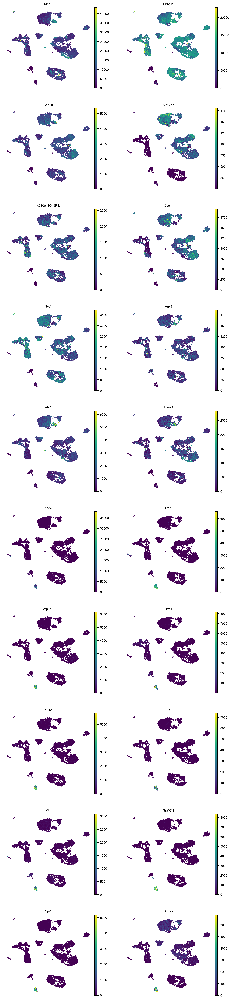

In [133]:
# if quick checking the marker gene expression distribution ( 3 each gene for both up and down regulated and control)
_check_markers=True
if _check_markers:
    sel_gene_list_plot=[]
    for _gene in sel_gene_list_dict['upregulated'][:10]:
        sel_gene_list_plot.append(_gene)
    for _gene in sel_gene_list_dict['downregulated'][:10]:
        sel_gene_list_plot.append(_gene)
    if add_control:
        for _gene in sel_gene_list_dict['control'][-3:]:
            sel_gene_list_plot.append(_gene)    
        
    #_filtered_gene_list = [_g for _g in sel_gene_list_plot if _g in adata.var.index]
    sc.pl.umap(adata, color=sel_gene_list_plot,ncols=2,legend_loc='on data')